In [1]:
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from nltk.corpus import stopwords
import json
import string
import re

import matplotlib.pyplot as plt
import seaborn as sns

import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel


import pyLDAvis
import pyLDAvis.gensim

# import data

In [2]:
video_df = pd.read_csv('../../data/video_transcripts_mix_clean.csv')

In [54]:
video_df['published_at'].max()

'2021-12-08 05:20:47'

In [55]:
video_df['published_at'].min()

'2020-07-27 21:49:32'

In [4]:
video_df.head(5)

,video_id,title,channel_id,channel_title,published_at,view_count,likes,dislikes,comment_count,tags,description,comments,Is_Generated,Transcript_Blob,title_Clean,tags_Clean,description_Clean,Transcript_Blob_Clean
0,--0bCF-iK2E,Jadon Sancho Magical Skills & Goals,UC6UL29enLNe4mqwTfAyeNuw,Bundesliga,2021-07-01 10:00:00,1048888,19515,226,1319,football soccer ftbol alemn Bundesliga season ...,Enjoy the best skills and goals from Jadon San...,"Respect to Dortmund fans,must be sad losing hi...",NaN,NaN,jadon sancho magic skill goal,footbal soccer ftbol alemn bundesliga season 2...,enjoy best skill goal jadon sancho sub httpsre...,NaN
1,--14w5SOEUs,Migos - Avalanche (Official Video),UCGIelM2Dj3zza3xyV3pL3WQ,MigosVEVO,2021-06-10 16:00:00,15352638,359277,7479,18729,Migos Avalanche Quality Control Music/Motown R...,"Watch the the official video for Migos - ""Aval...",Migos just makes me want to live my live to th...,False,[BAND SOUNDS] - HOW WOULD I DESCRIBE\nTHIS AL...,migo avalanch offici video,migo avalanch qualiti control musicmotown reco...,watch offici video migo avalanch streamdownloa...,"['describe', 'album', 'level', 'know', 'saying..."
2,--40TEbZ9Is,Supporting Actress in a Comedy: 73rd Emmys,UClBKH8yZRcM4AsRjDVEdjMg,Television Academy,2021-09-20 01:03:32,925281,11212,401,831,,Hannah Waddingham wins the Emmy for Supporting...,Hannah's energy bursts through any screen. Wel...,True,[Music] hello hi what's happening that was wi...,support actress comedi 73rd emmi,NaN,hannah waddingham win emmi support actress com...,"['happen', 'wild', 'truly', 'insane', 'expect'..."
3,--4tfbSyYDE,JO1'YOUNG (JO1 ver.)' PERFORMANCE VIDEO,UCsmXiDP8S40uBeJYxvyulmA,JO1,2021-03-03 10:00:17,2641597,39131,441,3745,PRODUCE101JAPAN JO1 TheSTAR STA...,JO1'YOUNG (JO1 ver.)' PERFORMANCE VIDEO\n\n---...,youngVer>< REN is really PERFECT. It's not ju...,NaN,NaN,jo1young jo1 ver perform video,produce101japan jo1 thestar stargaz protostar ...,jo1young jo1 ver perform video jo1 3rd singl c...,NaN
4,--DKkzWVh-E,Why Retaining Walls Collapse,UCMOqf8ab-42UUQIdVoKwjlQ,Practical Engineering,2021-12-07 13:00:00,715724,32887,367,1067,retaining wall New Jersey highway Direct Conne...,One of the most important (and innocuous) part...,Keep up with all my projects here: https://pr...,False,"Why Retaining Walls Fail In March of 2021, a ...",retain wall collaps,retain wall new jersey highway direct connect ...,one import innocu part construct environ use c...,"['wall', 'long', 'run', 'construction', 'proje..."


In [5]:
video_ts_df = video_df[video_df['Transcript_Blob_Clean'].notna()]
video_no_ts_df = video_df[video_df['Transcript_Blob_Clean'].isna()]

print(video_ts_df.shape)
#print(video_no_ts_df.shape)

(20960, 18)


In [6]:
print(video_ts_df.iloc[0]['Transcript_Blob_Clean'])
#print(video2_ts_df.iloc[0]['Transcript_Blob_Clean'])

['describe', 'album', 'level', 'know', 'saying', 'know', 'say', 'listen', 'know', 'say', 'take', 'back', 'roots', 'take', 'back', 'back', 'poppa', 'got', 'alone', 'hustle', 'try', 'keep', 'shit', 'together', 'young', 'smoking', 'live', 'fast', 'foot', 'got', 'back', 'past', 'know', 'rockin', 'term', 'relate', 'ain', 'never', 'pops', 'feel', 'big', 'dogs', 'see', 'shit', 'think', 'better', 'get', 'stick', 'come', 'mandela', 'mandela', 'willing', 'feed', 'help', 'judge', 'watch', 'ain', 'facade', 'young', 'beat', 'charge', 'gone', 'spend', 'cash', 'card', 'like', 'natural', 'get', 'fake', 'ass', 'ain', 'wrong', 'back', 'enjoy', 'get', 'walk', 'check', 'clout', 'knowin', 'get', 'bread', 'spend', 'matching', 'cover', 'spend', 'dime', 'double', 'seal', 'sign', 'deal', 'money', 'give', 'chill', 'chills', 'make', 'make', 'stick', 'field', 'make', 'lick', 'rack', 'teeth', 'always', 'challenge', 'well', 'greater', 'develop', 'sound', 'long', 'come', 'know', 'say', 'master', 'master', 'different

# build model

In [7]:
vectorizer = TfidfVectorizer(
   lowercase=True,
   max_features=200,
   max_df=.85,
   min_df=10,
   ngram_range=(1,3)
)

In [8]:
vectors = vectorizer.fit_transform(video_ts_df['Transcript_Blob_Clean'])

In [9]:
def print_to_file(list, file):
    with open(file, 'w') as file:
        for item in list:
            file.write(str(item) + '\n')

In [10]:
def cluster_by_col(df, col, max_features, n_clusters):
    df_notna = df[df[col].notna()]

    vectorizer = TfidfVectorizer(
        lowercase=True,
        max_features=max_features,
        max_df=.85,
        min_df=5,
        ngram_range=(1,3)
    )

    print("begin training")
    vectors = vectorizer.fit_transform(df_notna[col])
    print("training complete")
    feature_names = vectorizer.get_feature_names_out()

    dense = vectors.todense()

    denselist = dense.tolist()

    all_keywords = []

    for transcript in denselist:
        x = 0
        keywords = []
        for word in transcript:
            if word > 0:
                keywords.append(feature_names[x])
            x = x+1
        all_keywords.append(keywords)

    print(len(all_keywords))
    print_to_file(all_keywords, f'../../data/all_spacey_{col}_keywords.txt')

    model = KMeans(n_clusters=n_clusters, init='k-means++', max_iter=100, n_init=1)
    model.fit(vectors)

    order_centroids = model.cluster_centers_.argsort()[:,::-1]
    terms = vectorizer.get_feature_names_out()

    with open (f'../../data/{col}_clusters.txt', 'w') as file:
        for i in range(n_clusters):
            file.write(f"Cluster {i}\n")
            for j in order_centroids[i, :20]:
                file.write( " %s\n" % terms[j],)
            file.write('\n\n')

    return (model, vectors)


In [11]:

def plot_cluster_hist(df, n_clusters, kmeans):
    labels = kmeans.labels_
    plt.figure(figsize=(10, 5))

    for i in range(n_clusters):
        cluster_titles = df['title'][labels == i]
        
        lengths = [len(title) for title in cluster_titles]

        plt.hist(lengths, alpha=0.5, label=f'Cluster {i}')

    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.legend(loc='upper right')
    plt.title('Histogram of Vectors in Clusters')

    plt.show()

In [12]:
def generate_color_list(num_colors):
    cmap = plt.get_cmap('tab20')  # Use a predefined colormap
    colors = [cmap(i) for i in range(num_colors)]
    return colors

In [13]:
def generate_rand_color_list(num_colors):
    colors = np.random.rand(num_colors, 3)
    return colors.tolist()

In [14]:
km_indices  = []

In [26]:
def plot_cluster(df, model, vectors, num_colors):
    kmean_indices = model.fit_predict(vectors)

    pca = PCA(n_components=2)

    scatter_plot_points = pca.fit_transform(vectors.toarray())

    #colors = generate_color_list(100)
    colors = generate_rand_color_list(num_colors)

    x_axis = [o[0] for o in scatter_plot_points]
    y_axis = [o[1] for o in scatter_plot_points]

    fig, ax = plt.subplots(figsize=(50,50))

    ax.scatter(x_axis, y_axis, c = [colors[c] for c in kmean_indices])

    centroids = model.cluster_centers_
    centroid_points = pca.transform(centroids)

    ax.scatter(centroid_points[:,0], centroid_points[:,1], marker='*', s=200, c='black')
    plt.show()

In [16]:
desc_model, desc_vectors = cluster_by_col(
    video_df, 'description_Clean', 100, 100)


begin training
training complete
36801


In [17]:
video_df.filter(regex='_Clean$', axis=1)

,title_Clean,tags_Clean,description_Clean,Transcript_Blob_Clean
0,jadon sancho magic skill goal,footbal soccer ftbol alemn bundesliga season 2...,enjoy best skill goal jadon sancho sub httpsre...,NaN
1,migo avalanch offici video,migo avalanch qualiti control musicmotown reco...,watch offici video migo avalanch streamdownloa...,"['describe', 'album', 'level', 'know', 'saying..."
2,support actress comedi 73rd emmi,NaN,hannah waddingham win emmi support actress com...,"['happen', 'wild', 'truly', 'insane', 'expect'..."
3,jo1young jo1 ver perform video,produce101japan jo1 thestar stargaz protostar ...,jo1young jo1 ver perform video jo1 3rd singl c...,NaN
4,retain wall collaps,retain wall new jersey highway direct connect ...,one import innocu part construct environ use c...,"['wall', 'long', 'run', 'construction', 'proje..."
...,...,...,...,...
37416,champion season 4 episod 4,br footbal bleacher report soccer footbal goal...,dejan lovren convinc virgil van dijk hide secr...,"['happen', 'world', 'elite', 'footballer', 'ma..."
37417,lil tjay call phone feat 6lack offici video,lil tjay steadi call phone call phone tiktok t...,offici video call phone lil tjay featur 6lack ...,NaN
37418,pelican laker full game highlight januari 15 2021,nba g leagu basketbal game0022000187 laker pel...,pelican laker full game highlight januari 15 2...,NaN
37419,mv mamamoo,mamamoo waw waw mamamoo waw wawn wawn,mv mamamoo instagram httpsbitly2trqpjd faceboo...,"['beautiful', 'dazzle', 'laugh', 'cry', 'excit..."


In [24]:
plot_cluster_hist(video_df, 100, desc_model)

IndexError: Boolean index has wrong length: 36801 instead of 37421

<Figure size 720x360 with 0 Axes>

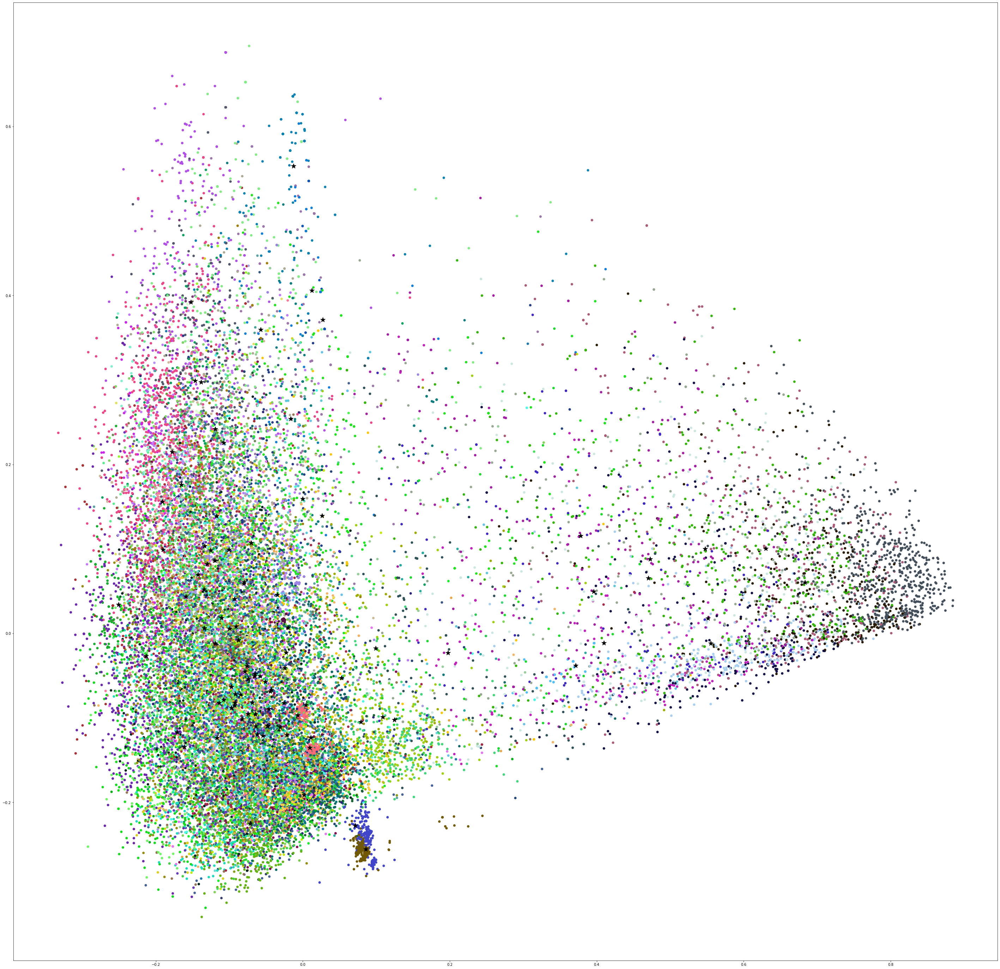

In [27]:

plot_cluster(video_df, desc_model, desc_vectors, 100)

In [29]:
desc_model_50, desc_vectors_50 = cluster_by_col(
    video_df, 'description_Clean', 50, 50)

begin training
training complete
36801


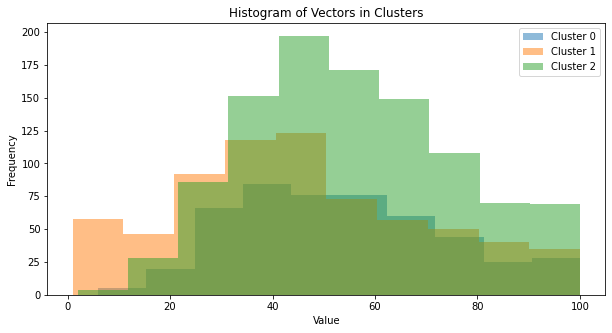

In [ ]:
plot_cluster_hist(video_df, 50, desc_model_50)

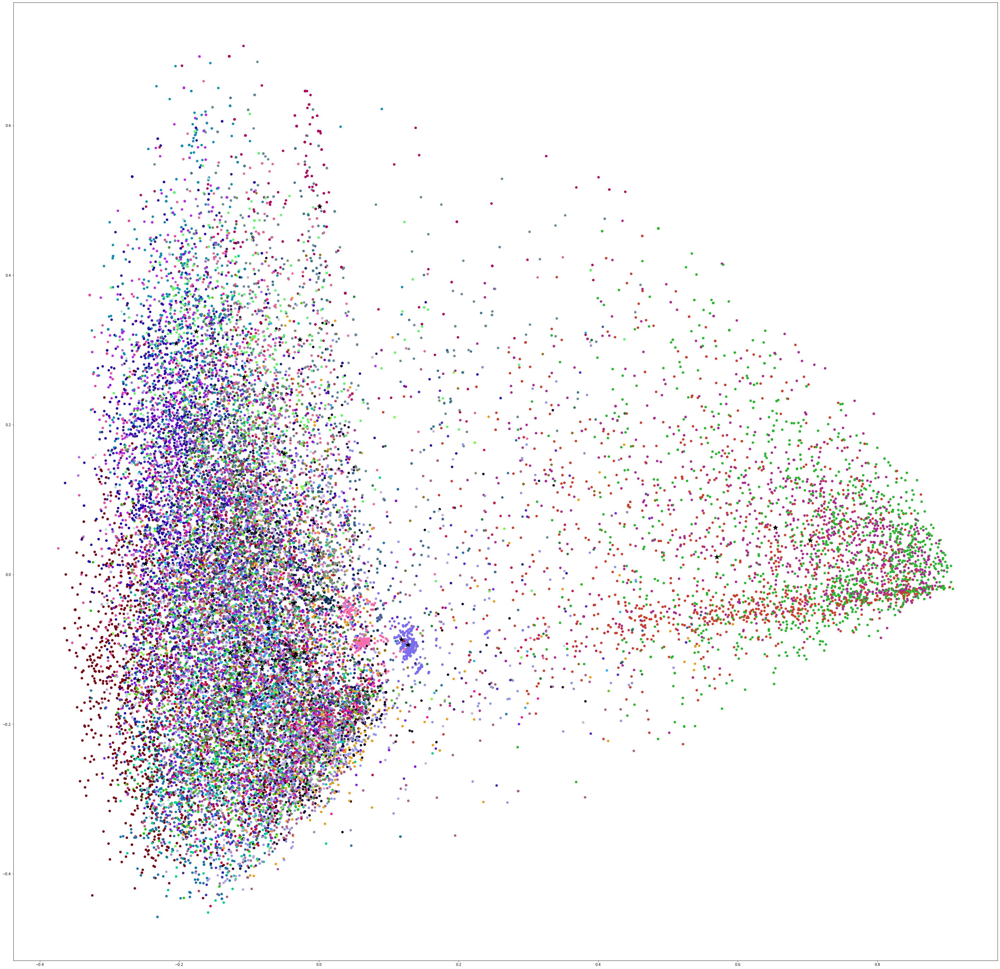

In [31]:
plot_cluster(video_df, desc_model_50, desc_vectors_50, 50)

In [32]:
desc_model_20, desc_vectors_20 = cluster_by_col(
    video_df, 'description_Clean', 20, 20)

begin training
training complete
36801


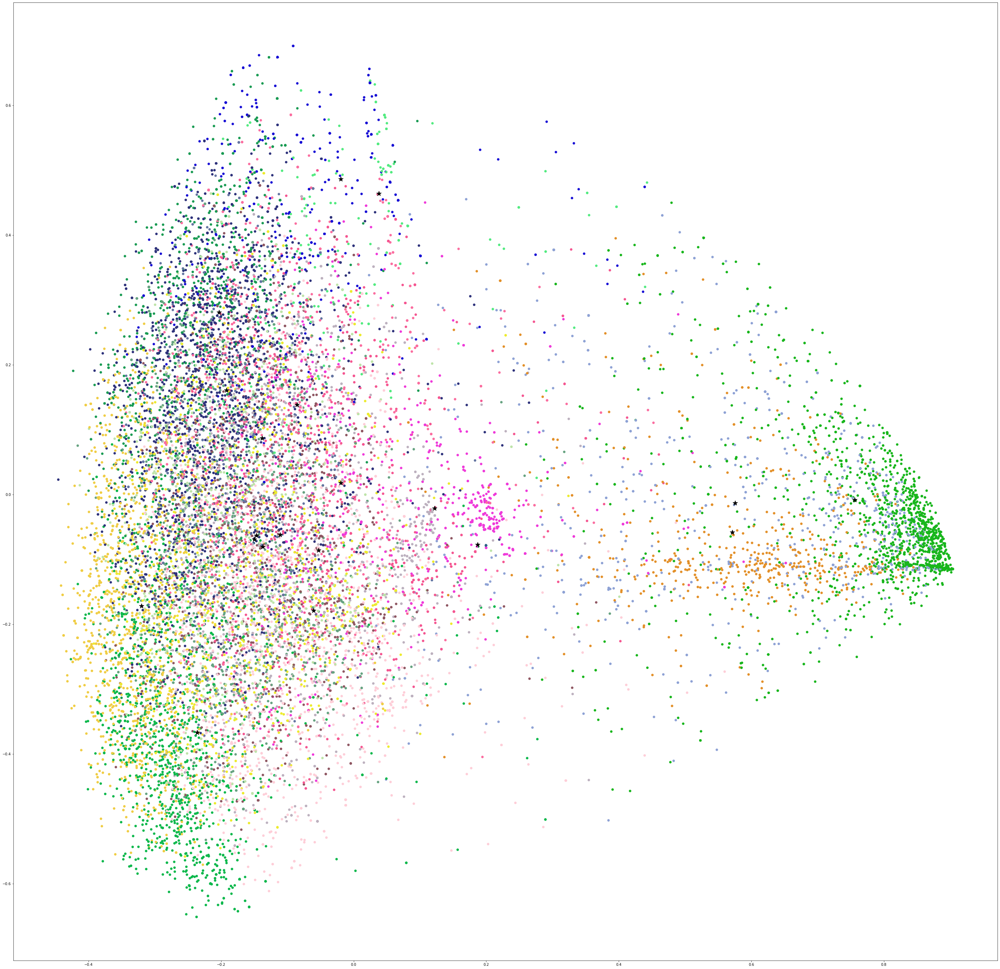

In [33]:
plot_cluster(video_df, desc_model_20, desc_vectors_20, 20)

In [34]:
title_model_100, title_vectors_100 = cluster_by_col(
    video_df, 'title_Clean', 100, 100)

begin training
training complete
37395


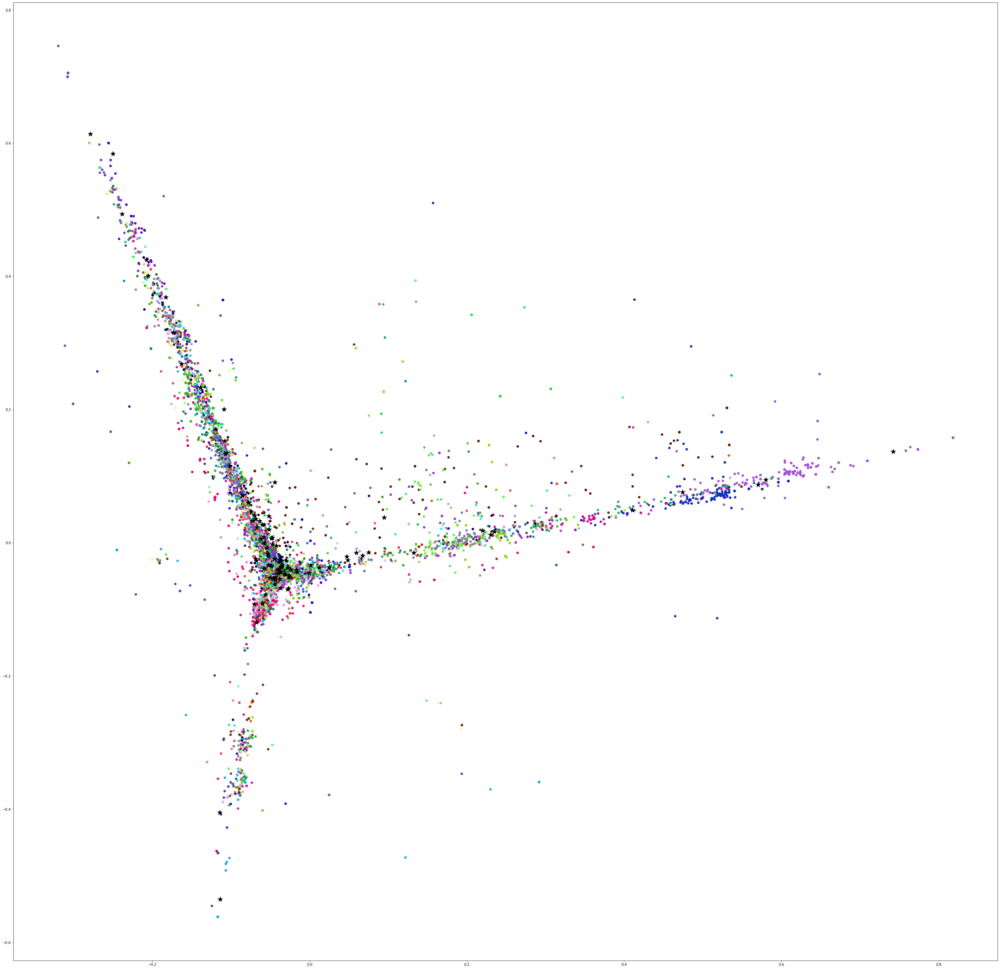

In [35]:
plot_cluster(video_df, title_model_100, title_vectors_100, 100)

In [37]:
title_model_50, title_vectors_50 = cluster_by_col(
    video_df, 'title_Clean', 50, 50)

begin training
training complete
37395


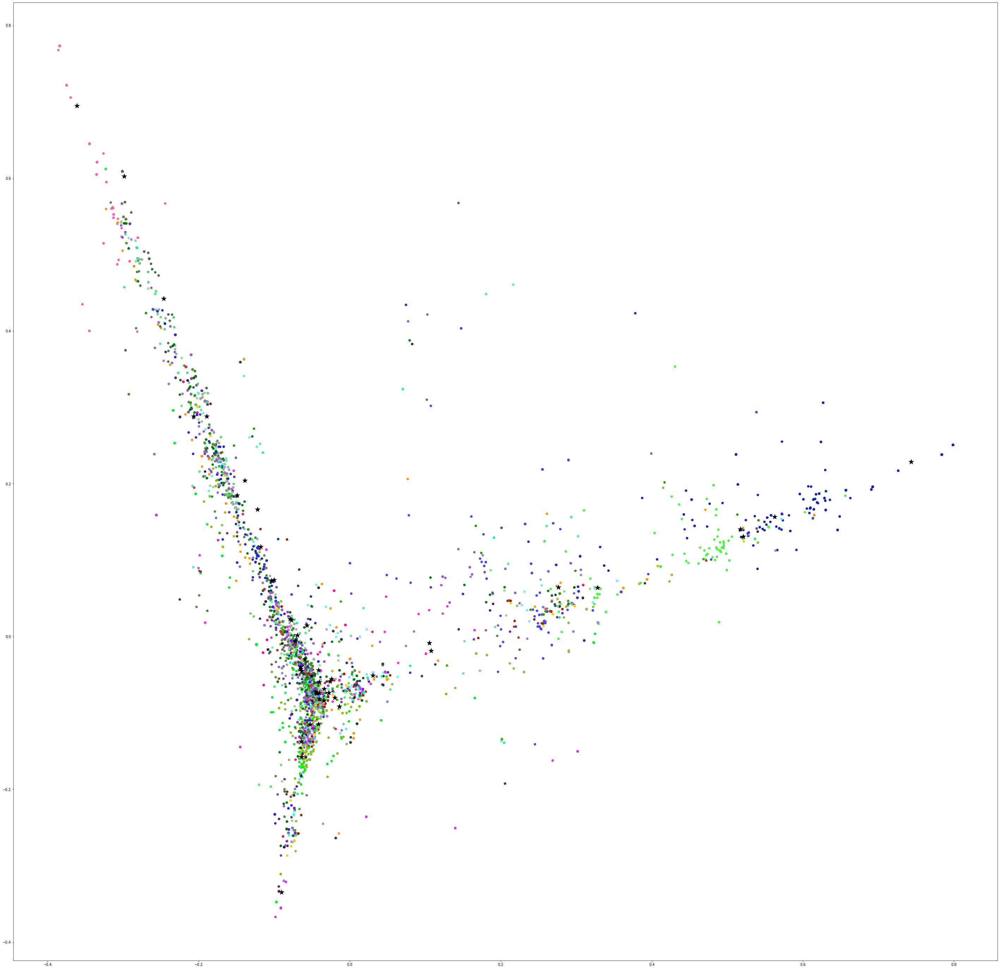

In [38]:
plot_cluster(video_df, title_model_50, title_vectors_50,50)

In [39]:
title_model_20, title_vectors_20 = cluster_by_col(
    video_df, 'title_Clean', 20, 20)

begin training
training complete
37395


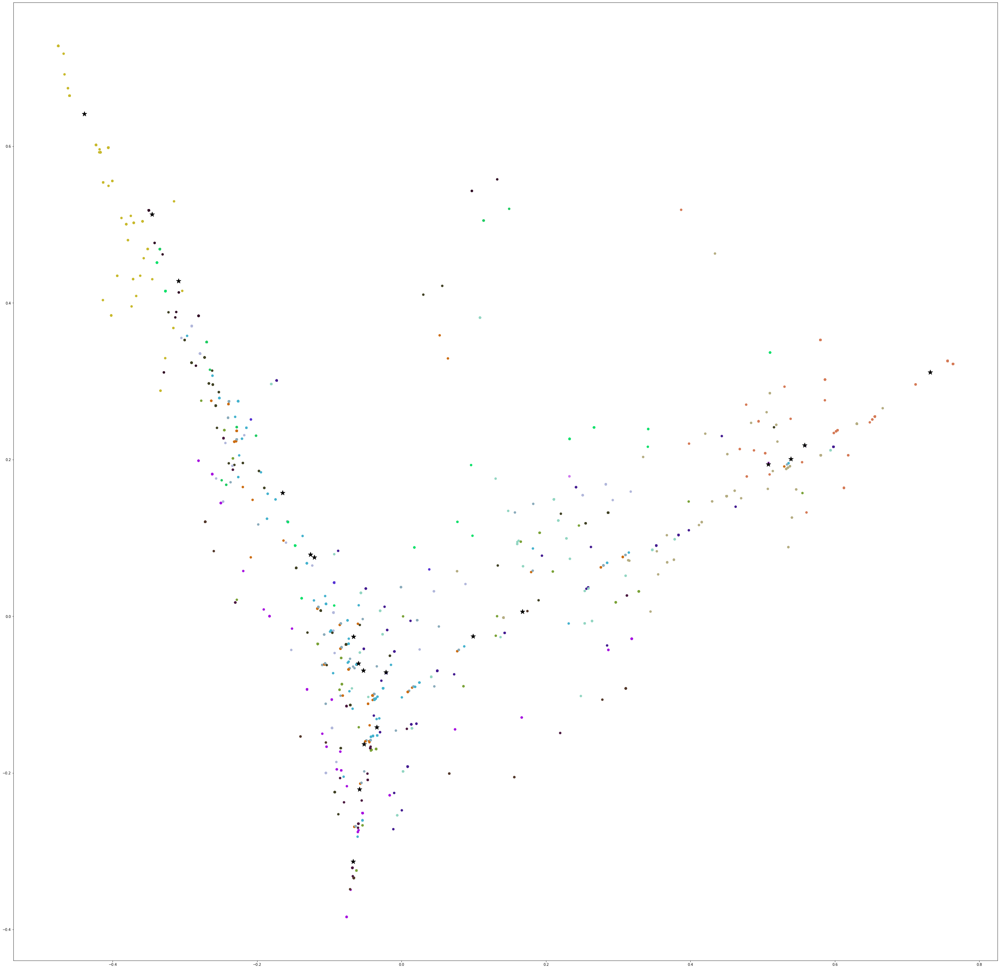

In [40]:
plot_cluster(video_df, title_model_20, title_vectors_20,20)

In [41]:
ts_model_100, ts_vectors_100 = cluster_by_col(
    video_df, 'Transcript_Blob_Clean', 100, 100)

begin training
training complete
20960


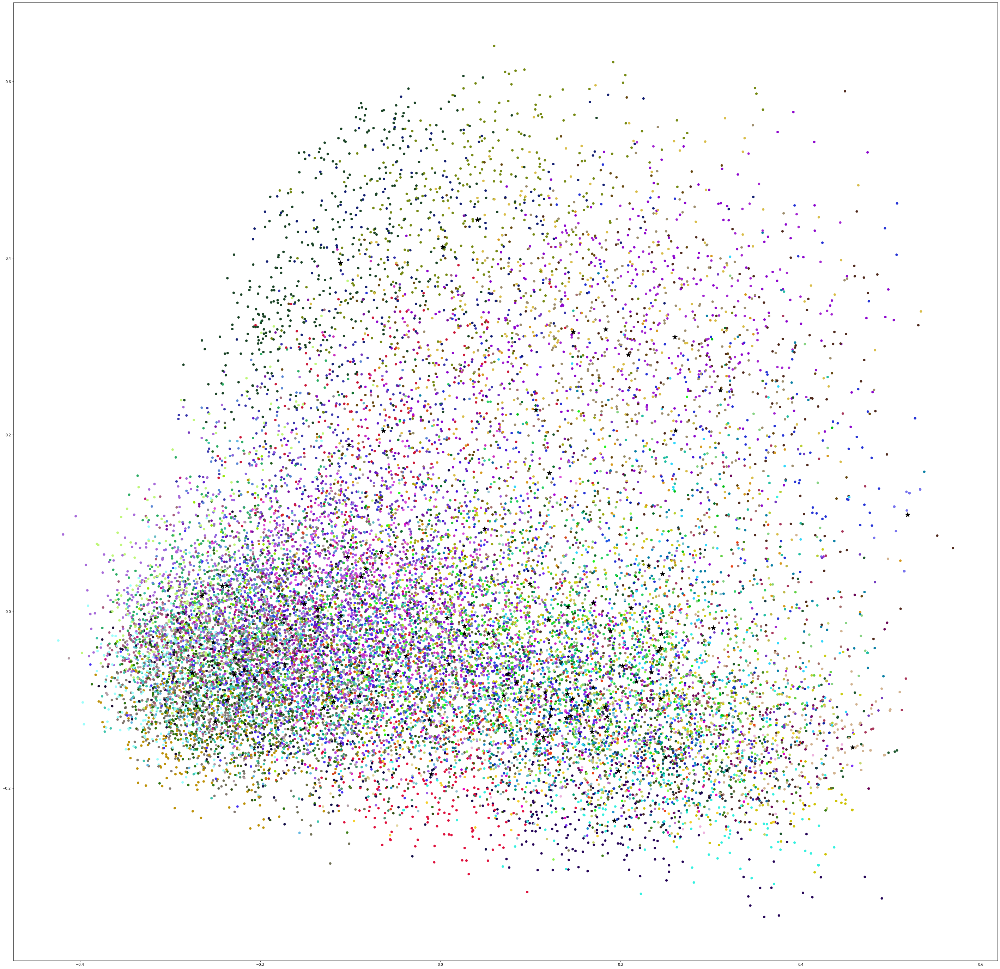

In [42]:
plot_cluster(video_df, ts_model_100, ts_vectors_100, 100)

In [44]:
ts_model_50, ts_vectors_50 = cluster_by_col(
    video_df, 'Transcript_Blob_Clean', 50, 50)

begin training
training complete
20960


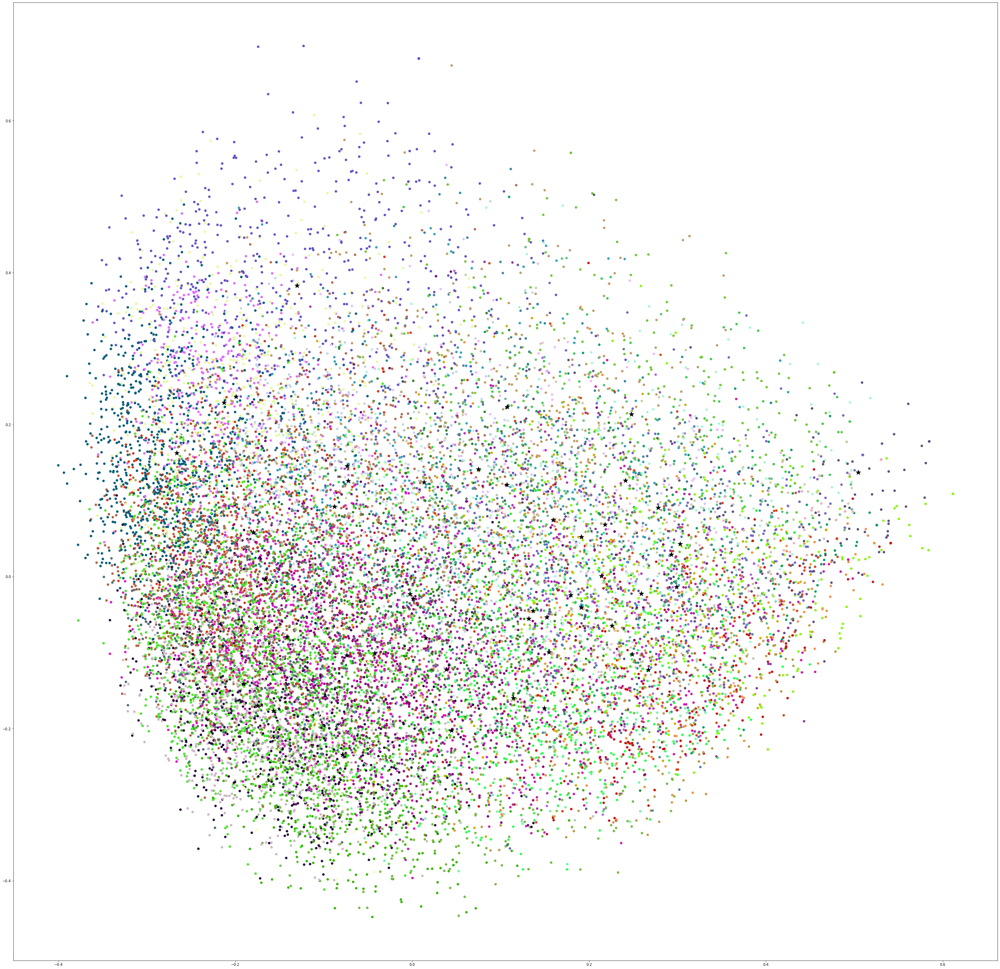

In [46]:
plot_cluster(video_df, ts_model_50, ts_vectors_50, 50)

In [48]:
ts_model_20, ts_vectors_20 = cluster_by_col(
    video_df, 'Transcript_Blob_Clean', 20, 20)

begin training
training complete
20960


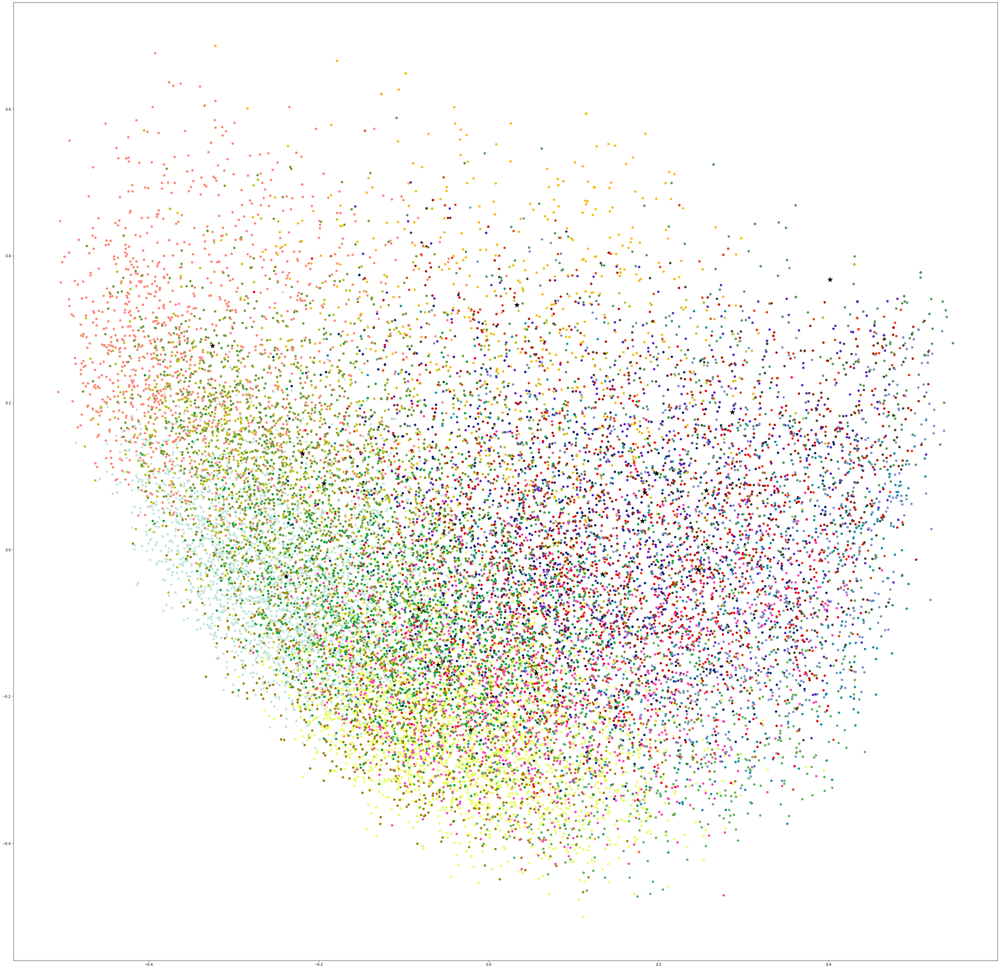

In [49]:
plot_cluster(video_df, ts_model_20, ts_vectors_20, 20)

In [50]:
ts_model_10, ts_vectors_10 = cluster_by_col(
    video_df, 'Transcript_Blob_Clean', 10, 10)

begin training
training complete
20960


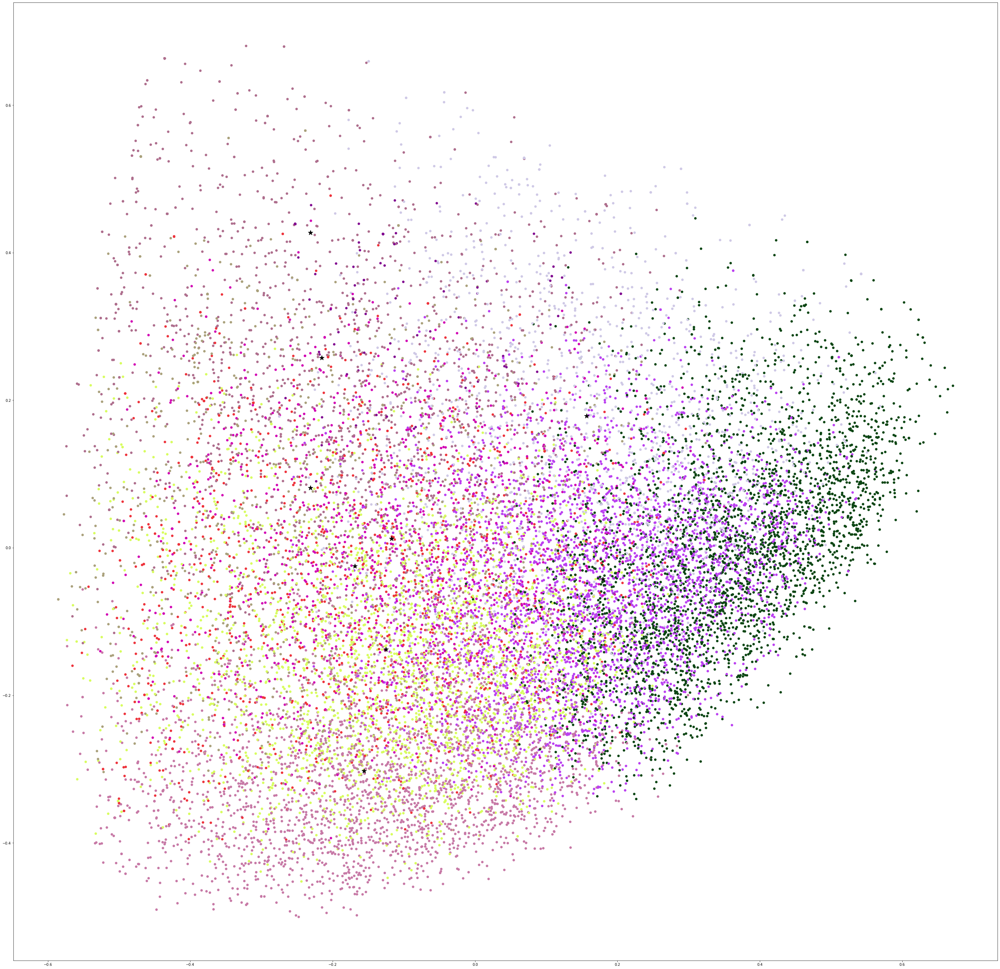

In [51]:
plot_cluster(video_df, ts_model_10, ts_vectors_10, 10)

In [52]:
ts_model_5, ts_vectors_5 = cluster_by_col(
    video_df, 'Transcript_Blob_Clean', 5, 5)

begin training
training complete
20960


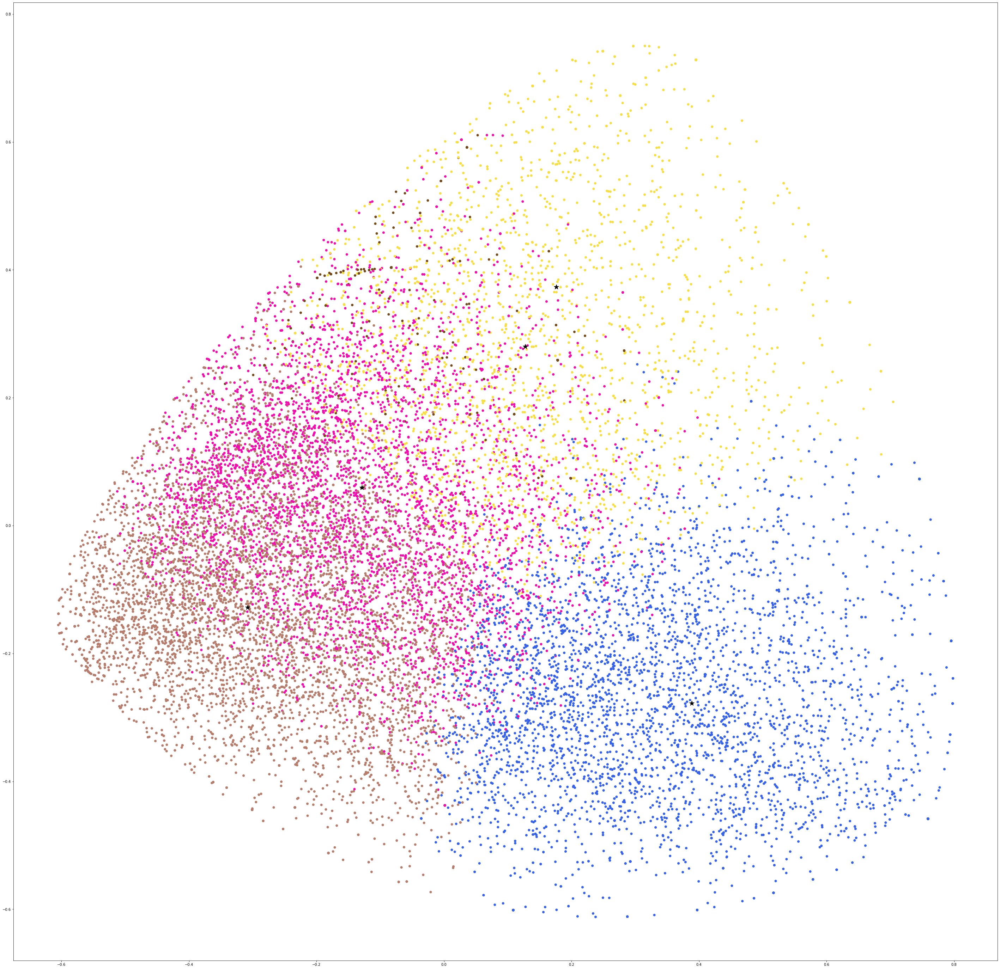

In [53]:
plot_cluster(video_df, ts_model_5, ts_vectors_5, 5)

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score
import pandas as pd

def combine_features(row, cols):
    return " ".join(" ".join(x) if isinstance(x, list) 
                    else str(x) for x in (row[col] for col in cols))

combinations = [
    ['title_Clean'],
    ['description_Clean'],
    ['tags_Clean'],
    ['Transcript_Blob_Clean'],
    ['title_Clean', 'description_Clean'],
    ['title_Clean', 'tags_Clean'],
    ['title_Clean', 'Transcript_Blob_Clean'],

    ['tags_Clean', 'description_Clean'],
    ['tags_Clean', 'Transcript_Blob_Clean'],

    ['description_Clean', 'Transcript_Blob_Clean'],

    ['title_Clean', 'description_Clean', 'tags_Clean'],
    ['title_Clean', 'description_Clean', 'Transcript_Blob_Clean'],

    ['Transcript_Blob_Clean', 'description_Clean', 'tags_Clean'], 

    ['title_Clean', 'Transcript_Blob_Clean', 'description_Clean', 'tags_Clean'], 
]

results = []
combined_df = pd.DataFrame()

for cols in combinations:
    combined_cols = '__'.join(cols)
    print(cols)
    combined_df[combined_cols] = video_df.apply(lambda row: combine_features(row, cols), axis=1)
    
    print("\tbegin training Tfidf")
    vectorizer = TfidfVectorizer(lowercase=True, max_features=200, max_df=0.85, min_df=10, ngram_range=(1, 3))
    X = vectorizer.fit_transform(combined_df[combined_cols])
    
    print("\tbegin training KMeans")
    model = KMeans(n_clusters=5, init='k-means++', max_iter=100, n_init=1)
    model.fit(X)
    
    print("\tscoring")
    silhouette_avg = silhouette_score(X, model.labels_)
    davies_bouldin = davies_bouldin_score(X.toarray(), model.labels_)
    
    results.append({'combination': combined_cols, 'silhouette_score': silhouette_avg, 'davies_bouldin_score': davies_bouldin})

# Convert results to DataFrame for easier visualization
combo_results_df = pd.DataFrame(results)
print(combo_results_df)

['title_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['description_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['tags_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['Transcript_Blob_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['title_Clean', 'description_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['title_Clean', 'tags_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['title_Clean', 'Transcript_Blob_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['tags_Clean', 'description_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['tags_Clean', 'Transcript_Blob_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['description_Clean', 'Transcript_Blob_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['title_Clean', 'description_Clean', 'tags_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['title_Clean', 'description_Clean', 'Transcr

In [21]:
combo_results_df

,combination,silhouette_score,davies_bouldin_score
0,title_Clean,0.119893,2.099339
1,description_Clean,0.052137,4.400402
2,tags_Clean,0.146512,2.836741
3,Transcript_Blob_Clean,0.450250,3.430228
4,title_Clean__description_Clean,0.060528,2.743378
5,title_Clean__tags_Clean,0.043279,3.755541
6,title_Clean__Transcript_Blob_Clean,0.238713,3.616403
7,tags_Clean__description_Clean,0.050164,4.140664
8,tags_Clean__Transcript_Blob_Clean,0.264170,2.782730
9,description_Clean__Transcript_Blob_Clean,0.142818,3.056386


In [ ]:
combo_results_df['combo'] = combo_results_df.apply( lambda x: '__'.join(x))

TypeError: sequence item 0: expected str instance, float found

In [ ]:
def plot_heatmap(df):
    df = df.melt(id_vars=['combination'], value_vars=['silhouette_score', 'davies_bouldin_score'], var_name='metric', value_name='score')

    # Create heatmap
    plt.figure(figsize=(10, 6))
    sns.heatmap(df.pivot('combination', 'metric', 'score'), annot=True, cmap='coolwarm', linewidths=.5)
    plt.title('Clustering Metrics for Different Feature Combinations')
    plt.xlabel('Metric')
    plt.ylabel('Feature Combination')
    plt.xticks(rotation=45)
    plt.yticks(rotation=0)
    plt.show()

In [ ]:
plot_heatmap(combo_results_df)

TypeError: unhashable type: 'list'

<Figure size 720x432 with 0 Axes>

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression


pipe = Pipeline([
    ('tfidf', TfidfVectorizer()),
    ('clf', LogisticRegression())
])

parameters = {
    'tfidf__lowercase': [True, False],
    'tfidf__max_features': [100, 200, 300, 500],
    'tfidf__max_df': [0.85, 0.9, 0.95],
    'tfidf__min_df': [1, 5, 10],
    'tfidf__ngram_range': [(1, 1), (1, 2), (1, 3)]
}

grid_search = GridSearchCV(pipe, parameters, cv=5, verbose=1, n_jobs=-1)
grid_search.fit(video_df['title'] + ' ' + video_df['tags'] + ' ' + video_df['description'])

print("Best parameters set:")
best_parameters = grid_search.best_estimator_.get_params()
for param_name in sorted(parameters.keys()):
    print(f"\t{param_name}: {best_parameters[param_name]}")

best_model = grid_search.best_estimator_